In [12]:
FLAGS = {"path", "chest", "derma", "oct", "pneumonia", "retina", "breast", "blood", "tissue"}
SPLITS = {"train", "val", "test"}

In [13]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import pandas as pd
from pathlib import Path

In [14]:
im_triples = {}
for flag in FLAGS:
    im_triples[flag] = {split: [] for split in SPLITS}
im_triples

{'retina': {'val': [], 'train': [], 'test': []},
 'pneumonia': {'val': [], 'train': [], 'test': []},
 'oct': {'val': [], 'train': [], 'test': []},
 'blood': {'val': [], 'train': [], 'test': []},
 'derma': {'val': [], 'train': [], 'test': []},
 'tissue': {'val': [], 'train': [], 'test': []},
 'path': {'val': [], 'train': [], 'test': []},
 'chest': {'val': [], 'train': [], 'test': []},
 'breast': {'val': [], 'train': [], 'test': []}}

In [15]:
for flag in FLAGS:
    print(flag, "Starting ...")
    mnist = np.load(f"/root/.medmnist/{flag}mnist.npz")
    mnist_replica = np.load(f"/mnt/jbrockma/bachelor-thesis/npz/{flag}mnist-replica.npz")
    ours = np.load(f"/mnt/jbrockma/bachelor-thesis/npz/{flag}.npz")
    for split in SPLITS:
        mnist_ims, mnist_replica_ims, our_ims = mnist[f"{split}_images"], mnist_replica[f"{split}_images"], ours[f"{split}_images"]
        if len(mnist_ims) != len(mnist_replica_ims) != len(our_ims):
            print((flag, split), "Different sample sizes", (len(mnist_ims), len(mnist_replica_ims), len(our_ims)))
        if  len(mnist_ims.shape) != len(mnist_replica_ims.shape) != len(our_ims.shape):
            print((flag, split), "Different image dimensions", (mnist_ims.shape, mnist_replica_ims.shape, our_ims.shape))
        rand_idcs = np.random.choice(min(len(mnist_ims), len(mnist_replica_ims), len(our_ims)), size=5, replace=False)
        for i in rand_idcs:
            mnist_im, mnist_replica_im, our_im = Image.fromarray(mnist_ims[i]), Image.fromarray(mnist_replica_ims[i]), Image.fromarray(our_ims[i])
            im_triples[f"{flag}"][f"{split}"].append((i, (mnist_im, mnist_replica_im, our_im)))
        mnist_las, mnist_replica_las, our_las = mnist[f"{split}_labels"], mnist_replica[f"{split}_labels"], ours[f"{split}_labels"]
        if mnist_las.shape != mnist_replica_las.shape != our_las.shape:
            print((flag, split), "Different label dimensions")
        mnist_comparison = mnist_las != mnist_replica_las
        our_comparison = mnist_las != our_las
        internal_comparison = mnist_replica_las != our_las
        if np.any(mnist_comparison):
            print((flag, split), "Labels different at the following indeces for MNIST replica", np.nonzero(mnist_comparison)[0])
        if np.any(our_comparison):
            print((flag, split), "Labels different at the following indeces for our version", np.nonzero(our_comparison)[0])
        if np.any(internal_comparison):
            print((flag, split), "Labels different at the following indeces for internal versions", np.nonzero(internal_comparison)[0])
        print((flag, split), "Done.")
    print(flag, "Done.")

retina Starting ...
('retina', 'val') Done.
('retina', 'train') Done.
('retina', 'test') Done.
retina Done.
pneumonia Starting ...
('pneumonia', 'val') Done.
('pneumonia', 'train') Done.
('pneumonia', 'test') Done.
pneumonia Done.
oct Starting ...
('oct', 'val') Done.
('oct', 'train') Done.
('oct', 'test') Done.
oct Done.
blood Starting ...
('blood', 'val') Done.
('blood', 'train') Done.
('blood', 'test') Done.
blood Done.
derma Starting ...
('derma', 'val') Done.
('derma', 'train') Done.
('derma', 'test') Done.
derma Done.
tissue Starting ...
('tissue', 'val') Done.
('tissue', 'train') Done.
('tissue', 'test') Done.
tissue Done.
path Starting ...
('path', 'val') Done.
('path', 'train') Done.
('path', 'test') Done.
path Done.
chest Starting ...
('chest', 'val') Done.
('chest', 'train') Done.
('chest', 'test') Done.
chest Done.
breast Starting ...
('breast', 'val') Done.
('breast', 'train') Done.
('breast', 'test') Done.
breast Done.


In [16]:
src_im = {}
for flag in FLAGS:
    src_im[flag] = {split: [] for split in SPLITS}
src_im

{'retina': {'val': [], 'train': [], 'test': []},
 'pneumonia': {'val': [], 'train': [], 'test': []},
 'oct': {'val': [], 'train': [], 'test': []},
 'blood': {'val': [], 'train': [], 'test': []},
 'derma': {'val': [], 'train': [], 'test': []},
 'tissue': {'val': [], 'train': [], 'test': []},
 'path': {'val': [], 'train': [], 'test': []},
 'chest': {'val': [], 'train': [], 'test': []},
 'breast': {'val': [], 'train': [], 'test': []}}

In [17]:
for flag in FLAGS:
    print(flag, "Starting ...")
    split_info = pd.read_csv(f'/mnt/jbrockma/bachelor-thesis/medmnist_data_split/{flag}mnist_split_info.csv')
    pattern = "*"
    if flag == "retina":
        pattern = "**/regular_fundus_images/**/*"
    elif flag == "tissue":
        pattern = "**/All_3D/**/*"
    for split in SPLITS:
        image_ids = [split_info[(split_info["split"] == split) & (split_info['index'] == i)]['image_id'].values[0] for i, _ in im_triples[flag][split]]
        ndarray_of_image_id = {}
        for child in Path(f'/mnt/jbrockma/bachelor-thesis/data/{flag}').rglob(pattern):
            if child.stem in image_ids:
                with Image.open(child) as im:
                    ndarray_of_image_id[child.stem] = np.asarray(im)
        for image_id in image_ids:
            src_im[flag][split].append(ndarray_of_image_id[image_id])
    print(flag, "Done.")

retina Starting ...
retina Done.
pneumonia Starting ...
pneumonia Done.
oct Starting ...
oct Done.
blood Starting ...
blood Done.
derma Starting ...
derma Done.
tissue Starting ...
tissue Done.
path Starting ...
path Done.
chest Starting ...
chest Done.
breast Starting ...
breast Done.


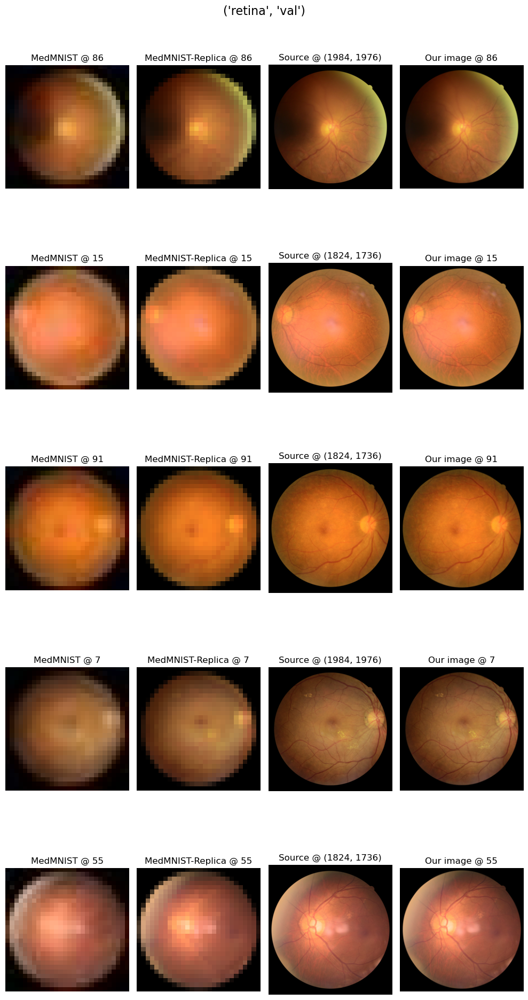

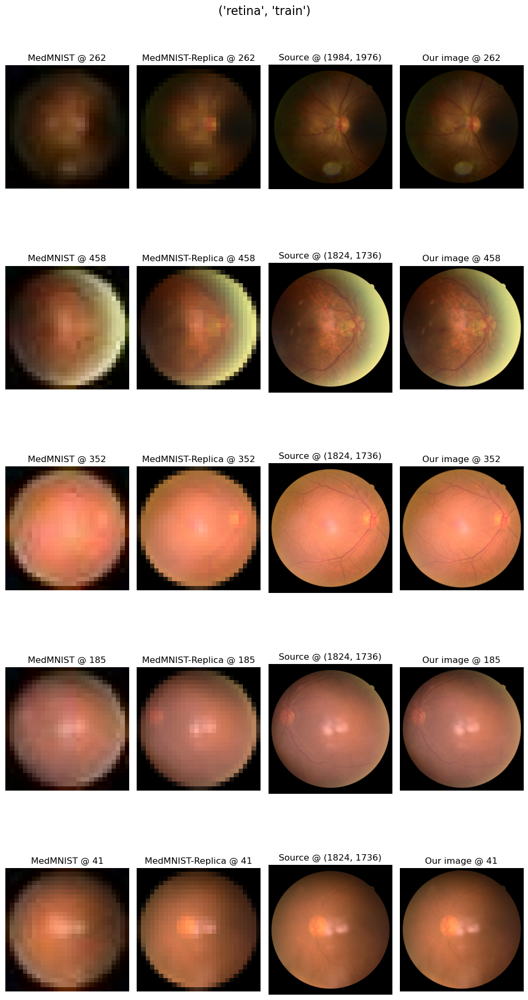

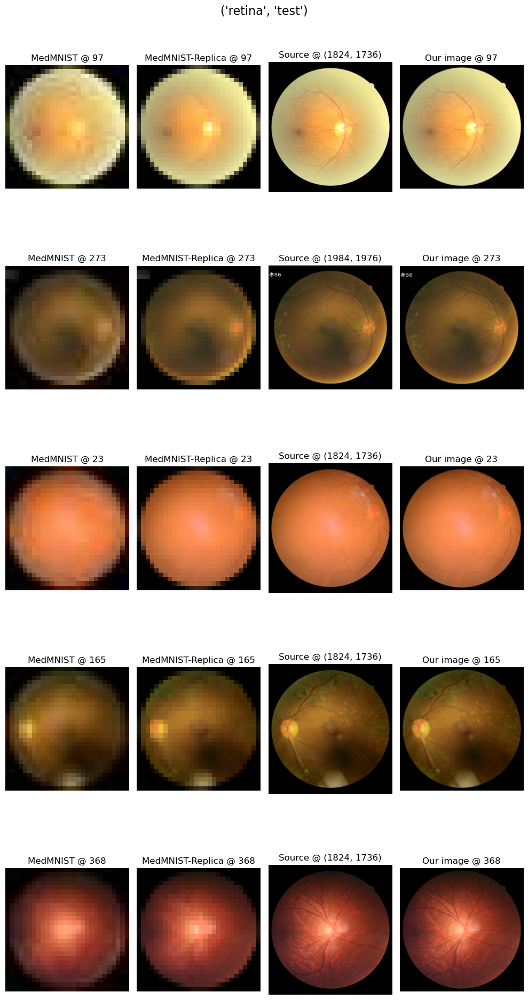

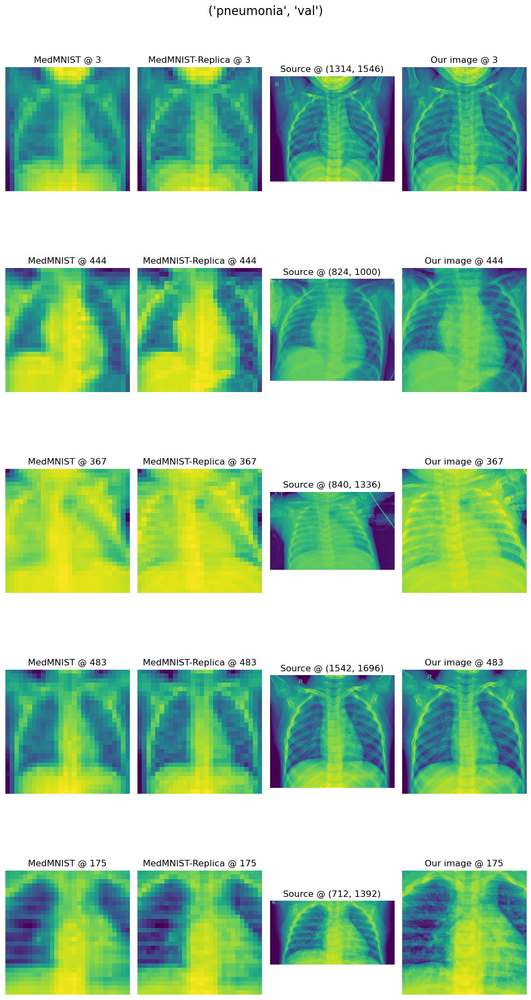

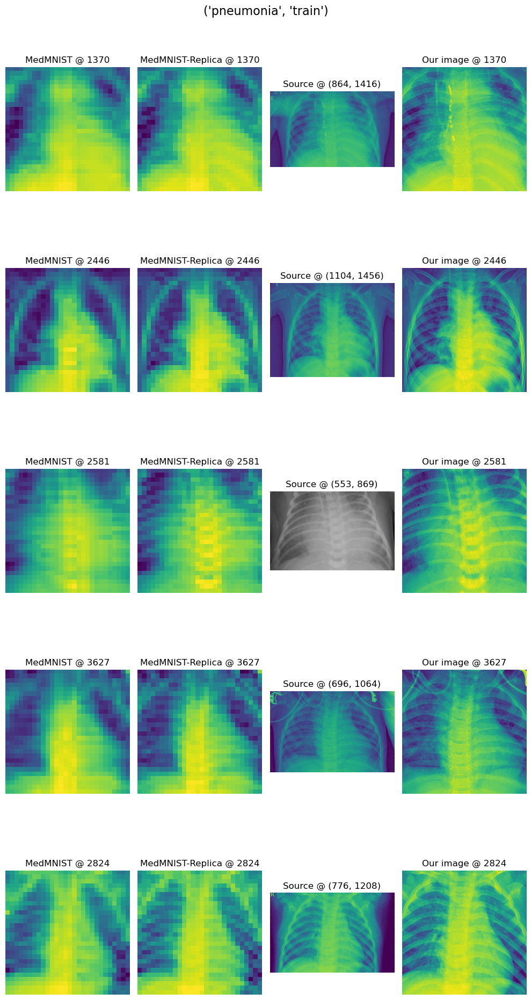

...

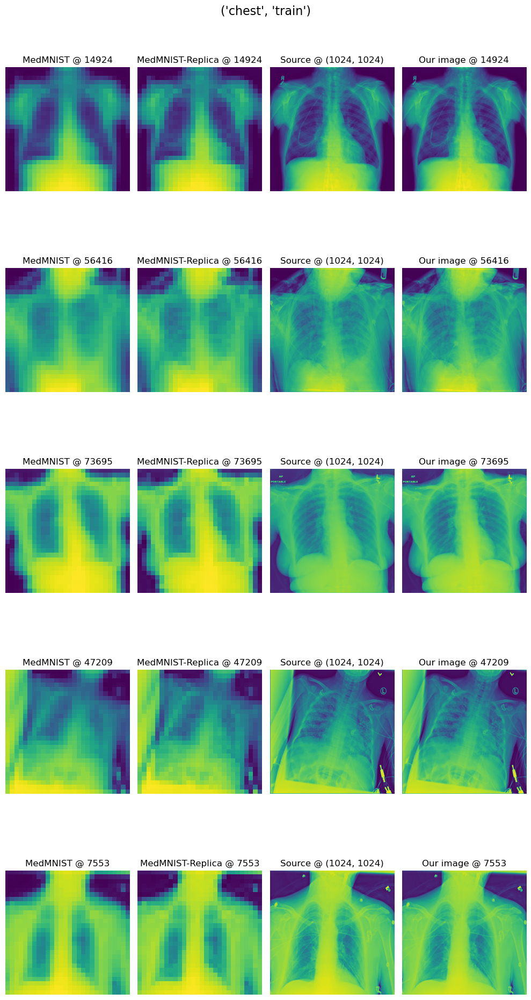

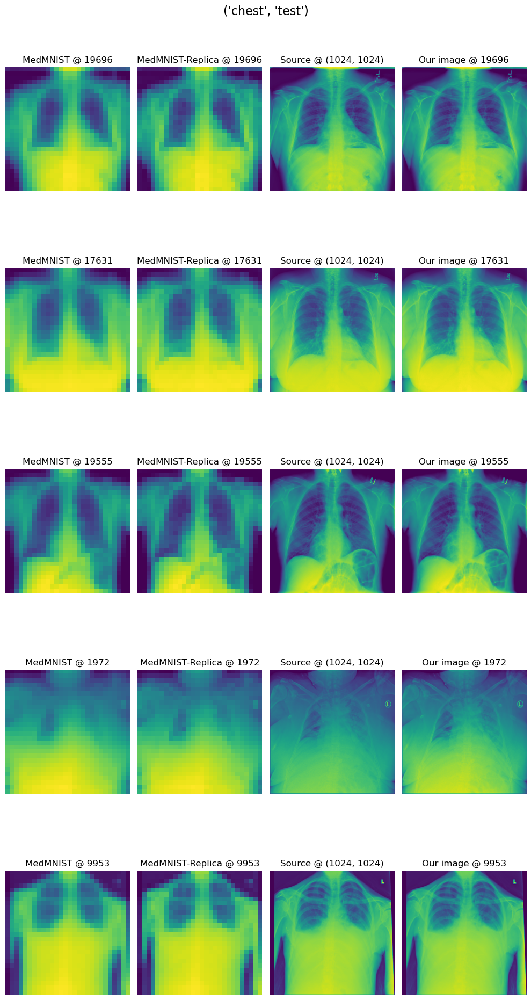

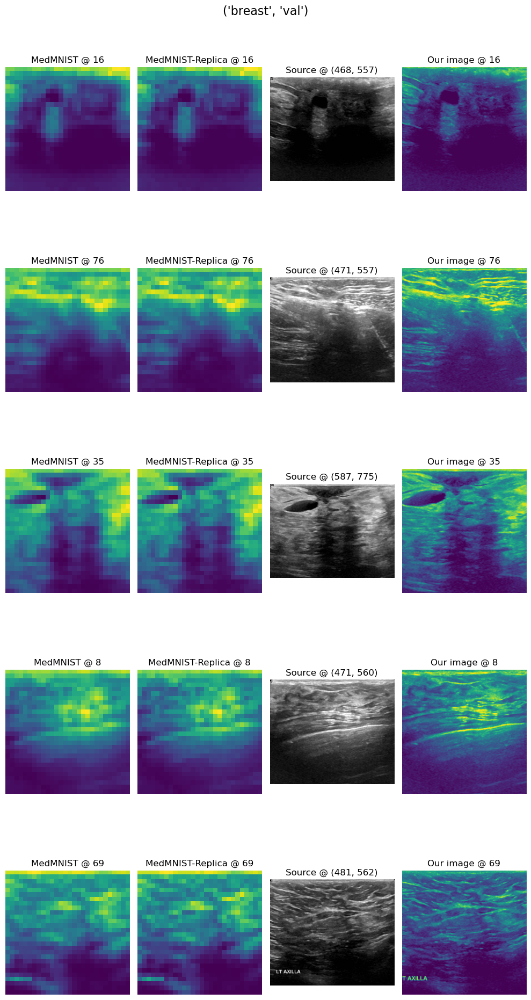

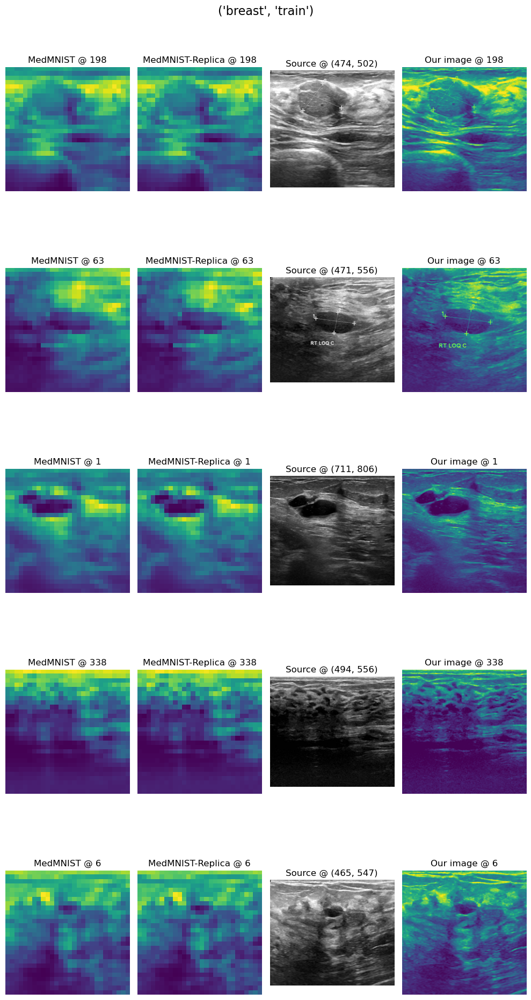

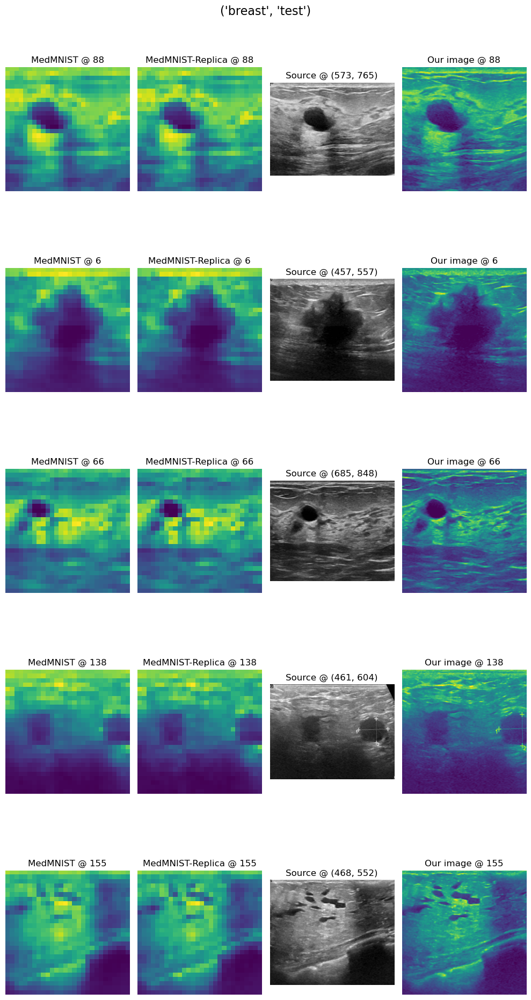

In [18]:
for flag in FLAGS:
    for split in SPLITS:
        # Create a figure and axis for the grid layout
        fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(10, 20))

        # Loop through each pair of images and display them side by side
        for i, (idx, im_triple) in enumerate(im_triples[flag][split]):
            for j, im in zip([0, 1, 3], im_triple):
                axes[i, j].imshow(im)
                axes[i, j].axis("off")

            axes[i, 0].set_title(f"MedMNIST @ {idx}")
            axes[i, 1].set_title(f"MedMNIST-Replica @ {idx}")

            axes[i, 2].imshow(src_im[flag][split][i])
            axes[i, 2].axis("off")

            axes[i, 2].set_title(f"Source @ {src_im[flag][split][i].shape[:2]}")
            axes[i, 3].set_title(f"Our image @ {idx}")

        fig.suptitle(f"{(flag, split)}", fontsize=16)

        # Adjust layout and show the plot
        plt.tight_layout()
        plt.show()